In [1]:
import numpy as np
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision.transforms as T
from torchvision.transforms import functional as F
import cv2
from PIL import Image
from torch.utils.data import Dataset, DataLoader
from torchmetrics.image import PeakSignalNoiseRatio, StructuralSimilarityIndexMeasure
from tqdm import tqdm
import warnings
import wandb
import torch.optim.lr_scheduler as lr_scheduler
import os
import torchvision.transforms.v2 as transforms
from PIL import Image

warnings.filterwarnings("ignore")
torch.manual_seed(42)
np.random.seed(42)

In [2]:
# from kaggle_secrets import UserSecretsClient
# user_secrets = UserSecretsClient()
# secret_value_0 = user_secrets.get_secret("WANDB_API_KEY")

# wandb.login(key = secret_value_0)

In [3]:
class DnCNN(nn.Module):
    def __init__(self, depth=20, channels=128):
        super(DnCNN, self).__init__()

        layers = [
            nn.Conv2d(
                in_channels=3,
                out_channels=channels,
                kernel_size=3,
                padding=1,
                bias=False,
            ),
            nn.ReLU(inplace=True),
        ]

        for _ in range(depth - 2):
            layers.append(
                nn.Conv2d(
                    in_channels=channels,
                    out_channels=channels,
                    kernel_size=3,
                    padding=1,
                    bias=False,
                )
            )
            layers.append(nn.BatchNorm2d(channels))
            layers.append(nn.ReLU(inplace=True))

        layers.append(
            nn.Conv2d(
                in_channels=channels,
                out_channels=3,
                kernel_size=3,
                padding=1,
                bias=False,
            )
        )

        self.dncnn = nn.Sequential(*layers)

    def forward(self, x):
        noise = self.dncnn(x)
        return noise

In [4]:
def save_image(tensor, path):
    if tensor.is_cuda:
        tensor = tensor.cpu()
    tensor = torch.clamp(tensor, 0, 1)
    img = F.to_pil_image(tensor)
    img.save(path)
    return True


def create_comparison_image(
    noisy_tensor, denoised_tensor, original_tensor=None, save_path=None
):
    if noisy_tensor.is_cuda:
        noisy_tensor = noisy_tensor.cpu()
    if denoised_tensor.is_cuda:
        denoised_tensor = denoised_tensor.cpu()

    noisy_img = F.to_pil_image(torch.clamp(noisy_tensor, 0, 1))
    denoised_img = F.to_pil_image(torch.clamp(denoised_tensor, 0, 1))

    if original_tensor is not None:
        if original_tensor.is_cuda:
            original_tensor = original_tensor.cpu()
        original_img = F.to_pil_image(torch.clamp(original_tensor, 0, 1))

        # Create figure with 3 subplots
        fig, axes = plt.subplots(1, 3, figsize=(15, 5))

        axes[0].imshow(np.array(noisy_img))
        axes[0].set_title("Noisy")
        axes[0].axis("off")

        axes[1].imshow(np.array(denoised_img))
        axes[1].set_title("Denoised")
        axes[1].axis("off")

        axes[2].imshow(np.array(original_img))
        axes[2].set_title("Original")
        axes[2].axis("off")
    else:
        # Create figure with 2 subplots
        fig, axes = plt.subplots(1, 2, figsize=(10, 5))

        axes[0].imshow(np.array(noisy_img))
        axes[0].set_title("Noisy")
        axes[0].axis("off")

        axes[1].imshow(np.array(denoised_img))
        axes[1].set_title("Denoised")
        axes[1].axis("off")

    plt.tight_layout()

    if save_path:
        plt.savefig(save_path, bbox_inches="tight")
        plt.close(fig)
        return True
    else:
        return fig

In [5]:
class Inference_Denoising_Dataset(Dataset):
    def __init__(self, noisy_dir, original_dir):
        self.noisy_dir = noisy_dir
        self.original_dir = original_dir
        self.transform = transforms.Compose(
            [transforms.ToImage(), transforms.ToDtype(torch.float32, scale=True)]
        )

        self.noisy_images = sorted(os.listdir(noisy_dir))
        self.original_images = sorted(os.listdir(original_dir))

        assert len(self.noisy_images) == len(self.original_images), (
            "Mismatch in dataset sizes"
        )

    def __len__(self):
        return len(self.noisy_images)

    def __getitem__(self, idx):
        noisy_path = os.path.join(self.noisy_dir, self.noisy_images[idx])
        original_path = os.path.join(self.original_dir, self.original_images[idx])

        noisy_img = Image.open(noisy_path).convert("RGB")
        original_img = Image.open(original_path).convert("RGB")

        noisy_tensor = self.transform(noisy_img)
        original_tensor = self.transform(original_img)

        return {
            "noisy_tensor": noisy_tensor,
            "original_tensor": original_tensor,
        }

In [6]:
class Inference:
    def __init__(self, config):
        self.config = config
        self.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        print(f"Using device: {self.device}")

        self._prepare_dataloader()
        self._init_model()

        os.makedirs(self.config["output_dir"], exist_ok=True)

        self.psnr = PeakSignalNoiseRatio().to(self.device)
        self.ssim = StructuralSimilarityIndexMeasure().to(self.device)

    def _init_model(self):
        self.model = DnCNN(
            depth=self.config["depth"], channels=self.config["channels"]
        ).to(self.device)

        if os.path.isfile(self.config["model_path"]):
            checkpoint = torch.load(self.config["model_path"], map_location=self.device)
            self.model.load_state_dict(checkpoint)
            print(f"Model loaded from {self.config['model_path']}")
        else:
            raise FileNotFoundError(f"Model not found at {self.config['model_path']}")

        self.model.eval()

    def _prepare_dataloader(self):
        print("Preparing Data...")
        dataset = Inference_Denoising_Dataset(
            noisy_dir=self.config["noisy_dir"], original_dir=self.config["original_dir"]
        )

        self.val_loader = DataLoader(dataset, batch_size=1)
        print("Val Dataloader prepared !!")

    def run(self):
        self.psnr.reset()
        self.ssim.reset()
        total_psnr = 0
        total_ssim = 0

        with torch.no_grad():
            for idx, batch in enumerate(self.val_loader):
                noisy_img = batch["noisy_tensor"].to(self.device)
                original_img = batch["original_tensor"].to(self.device)
                filename = f"{self.config['filename_prefix']}_{idx}.png"
                predicted_noise = self.model(noisy_img)

                denoised_img = noisy_img - predicted_noise

                denoised_img = torch.clamp(denoised_img, 0, 1)

                save_path = os.path.join(self.config["output_dir"], filename)
                save_image(denoised_img[0], save_path)

                comparison_path = os.path.join(
                    self.config["output_dir"], f"comparison_{filename}"
                )
                create_comparison_image(
                    noisy_img[0], denoised_img[0], original_img[0], comparison_path
                )

                self.psnr.update(denoised_img, original_img)
                self.ssim.update(denoised_img, original_img)

                # Calculate per-image metrics
                img_psnr = PeakSignalNoiseRatio().to(self.device)
                img_ssim = StructuralSimilarityIndexMeasure().to(self.device)

                img_psnr.update(denoised_img, original_img)
                img_ssim.update(denoised_img, original_img)

                total_psnr += img_psnr.compute().item()
                total_ssim += img_ssim.compute().item()

                print(
                    f"{filename} - PSNR: {img_psnr.compute().item():.4f}, SSIM: {img_ssim.compute().item():.4f}"
                )

        avg_psnr = self.psnr.compute().item()
        avg_ssim = self.ssim.compute().item()

        per_img_psnr = total_psnr / len(self.val_loader)
        per_img_ssim = total_ssim / len(self.val_loader)

        print(f"\nAverage PSNR: {avg_psnr:.4f}")
        print(f"Average SSIM: {avg_ssim:.4f}")
        print(f"Per-image average PSNR: {per_img_psnr:.4f}")
        print(f"Per-image average SSIM: {per_img_ssim:.4f}")

        # Save metrics to a text file
        with open(os.path.join(self.config["output_dir"], "metrics.txt"), "w") as f:
            f.write(f"Average PSNR: {avg_psnr:.4f}\n")
            f.write(f"Average SSIM: {avg_ssim:.4f}\n")
            f.write(f"Per-image average PSNR: {per_img_psnr:.4f}\n")
            f.write(f"Per-image average SSIM: {per_img_ssim:.4f}\n")

In [10]:
infer_config = {
    "output_dir": "./Results",
    "depth": 17,
    "channels": 128,
    "model_path": "./Results/final_trained_model.pth",
    "noisy_dir": "./dataset/val_noisy35",
    "original_dir": "./dataset/val_original",
    "filename_prefix": "val",
}

In [11]:
inference = Inference(config=infer_config)

Using device: cuda
Preparing Data...
Val Dataloader prepared !!
Model loaded from ./Results/final_trained_model.pth


In [12]:
inference.run()

val_0.png - PSNR: 30.4099, SSIM: 0.7457
val_1.png - PSNR: 29.4912, SSIM: 0.7085
val_2.png - PSNR: 28.0219, SSIM: 0.7725
val_3.png - PSNR: 27.1029, SSIM: 0.7685
val_4.png - PSNR: 24.0529, SSIM: 0.7996
val_5.png - PSNR: 27.7628, SSIM: 0.7759
val_6.png - PSNR: 30.1233, SSIM: 0.7420
val_7.png - PSNR: 29.6126, SSIM: 0.7407
val_8.png - PSNR: 30.0061, SSIM: 0.7472
val_9.png - PSNR: 29.4991, SSIM: 0.7607
val_10.png - PSNR: 31.0405, SSIM: 0.8686
val_11.png - PSNR: 26.3623, SSIM: 0.8050
val_12.png - PSNR: 26.7189, SSIM: 0.7320
val_13.png - PSNR: 28.1799, SSIM: 0.7782
val_14.png - PSNR: 26.2781, SSIM: 0.8357

Average PSNR: 27.8867
Average SSIM: 0.7720
Per-image average PSNR: 28.3108
Per-image average SSIM: 0.7720


In [13]:
def visualize(image_directory, cols=3, comparison_plot=True):
    if comparison_plot:
        image_files = [
            f
            for f in os.listdir(image_directory)
            if f.startswith("comparison") and f.endswith(".png")
        ]
        cols = 1
    else:
        image_files = [
            f
            for f in os.listdir(image_directory)
            if not f.startswith("comparison") and f.endswith(".png")
        ]

    image_files.sort()

    num_images = len(image_files)

    rows = (num_images + cols - 1) // cols

    fig, axes = plt.subplots(rows, cols, figsize=(15, 5 * rows))
    axes = axes.flatten() if num_images > 1 else [axes]

    for i, img_name in enumerate(image_files):
        img_path = os.path.join(image_directory, img_name)
        img = cv2.imread(img_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        axes[i].imshow(img)
        axes[i].set_title(img_name, fontsize=10)
        axes[i].axis("off")

    for j in range(i + 1, len(axes)):
        axes[j].axis("off")

    plt.tight_layout()
    plt.show()

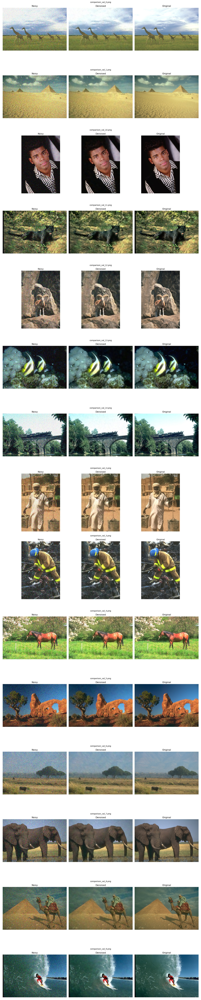

In [15]:
visualize("Results", cols=1, comparison_plot=True)

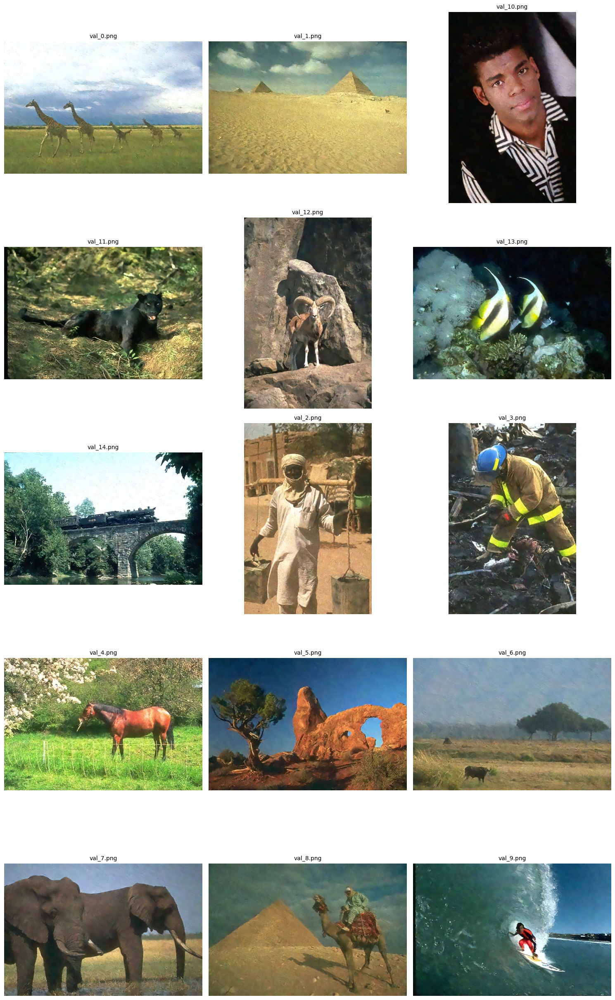

In [17]:
visualize("Results", cols=3, comparison_plot=False)